# CMS ex situ GIWAXS 2023C3

# Collin Samples CMS GIWAXS raw data processing & exporting notebook
In this notebook you output xr.DataSets stored as .zarr stores containing all your raw,
remeshed (reciprocal space), and caked CMS GIWAXS data. Saving as a zarr automatically converts the array to a dask array

In [2]:
### Kernel updates if needed, remember to restart kernel after running this cell!:
!pip install -e /nsls2/users/alevin/repos/PyHyperScattering  # to use pip to install via directory

Obtaining file:///nsls2/users/alevin/repos/PyHyperScattering
  Installing build dependencies ... done
  Checking if build backend supports build_editable ... done
  Getting requirements to build editable ... done
  Preparing editable metadata (pyproject.toml) ... done
  Building editable for PyHyperScattering (pyproject.toml) ... done
  Created wheel for PyHyperScattering: filename=PyHyperScattering-0.2.1+92.g6553b20-0.editable-py3-none-any.whl size=5355 sha256=a89162e92bb75711b7c8e63ed8352c1db6c051aab4cdb0c51785c960b188c2aa
  Stored in directory: /tmp/pip-ephem-wheel-cache-2jb7sact/wheels/7d/89/c7/db1d0cb1cf714f3a03a438abee7b78ce09921efd15259b1f5f
Successfully built PyHyperScattering
  Attempting uninstall: PyHyperScattering
    Found existing installation: PyHyperScattering 0.2.1
    Uninstalling PyHyperScattering-0.2.1:
      Successfully uninstalled PyHyperScattering-0.2.1


## Imports

In [33]:
### Imports:
import pathlib
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
import xarray as xr
import PyHyperScattering as phs
import pygix
import gc
from tqdm.auto import tqdm  # progress bar loader!

print(f'Using PyHyperScattering Version: {phs.__version__}')

Using PyHyperScattering Version: 0.2.1+92.g6553b20


## Defining some objects

### Define & check paths

In [34]:
# pix_size = 0.000172
# 668 * pix_size

In [36]:
# I like pathlib for its readability & checkability, it's also necessary for the loadSeries function later on
# Replace the paths with the ones relevant to your data, you can use the ".exists()" method to make sure you defined a path correctly
userPath = pathlib.Path('/nsls2/users/alevin')
propPath = pathlib.Path('/nsls2/data/cms/proposals/2023-3/pass-311415')
dataPath = propPath.joinpath('AL_processed_data/KWhite2/waxs')
rawPath = dataPath.joinpath('raw')
samplesPath = dataPath.joinpath('stitched')
calibPath = rawPath.joinpath('AgBH_cali_5m_12.7kev_x0.000_th0.000_10.00s_1307208_waxs.tiff')
maskponiPath = propPath.joinpath('AL_processed_data/maskponi')  # place for pyhyper-drawn masks and poni files

outPath = propPath.joinpath('AL_processed_data')

# Select poni & mask filepaths
poniFile = maskponiPath.joinpath('CeO2_2023-12-03_y673_x464p3.poni')
maskFile = maskponiPath.joinpath('pilatus1m_vertical_gaps_only.json')
# maskFile = maskponiPath.joinpath('blank.json')

# # Create pg Transform objects with the above information:
# # Can set the energy to overwrite default poni energy, this MUST be correct for your samples!
# pg_transformer = phs.GIWAXS.Transform(poniPath=poniFile, maskPath=None, energy=12.7)

# Colormap
cmap = plt.cm.turbo
cmap.set_bad('black')

In [37]:
def poni_centers(poniFile, pix_size=0.000172):
    """
    Returns poni center value and the corresponding pixel position. Default pixel size is 172 microns (Pilatus 1M)
    
    Inputs: poniFile as pathlib path object to the poni file
    Outputs: ((poni1, y_center), (poni2, x_center))
    """
    
    with poniFile.open('r') as f:
        lines = list(f.readlines())
    poni1_str = lines[6]
    poni2_str = lines[7]

    poni1 = float(poni1_str.split(' ')[1])
    poni2 = float(poni2_str.split(' ')[1])

    y_center = poni1 / pix_size
    x_center = poni2 / pix_size
        
    return ((poni1, y_center), (poni2, x_center))

poni_centers(poniFile)

((0.115756, 673.0), (0.07986737544963479, 464.34520610252787))

### Define metadata naming scheme & initialize loaders

In [38]:
[f.name for f in sorted(samplesPath.glob('*'))]

['AL_CS1-S_pos1_x-0.000_th0.080_10.00s_1306998_wax.tiff',
 'AL_CS1-S_pos1_x-0.000_th0.100_10.00s_1306999_wax.tiff',
 'AL_CS1-S_pos1_x-0.000_th0.120_10.00s_1307000_wax.tiff',
 'AL_CS1-S_pos1_x-0.000_th0.140_10.00s_1307001_wax.tiff',
 'AL_CS1_pos1_x-0.000_th0.080_10.00s_1306990_wax.tiff',
 'AL_CS1_pos1_x-0.000_th0.100_10.00s_1306991_wax.tiff',
 'AL_CS1_pos1_x-0.000_th0.120_10.00s_1306992_wax.tiff',
 'AL_CS1_pos1_x-0.000_th0.140_10.00s_1306993_wax.tiff',
 'AL_CS2-S_pos1_x-0.000_th0.080_10.00s_1307014_wax.tiff',
 'AL_CS2-S_pos1_x-0.000_th0.100_10.00s_1307015_wax.tiff',
 'AL_CS2-S_pos1_x-0.000_th0.120_10.00s_1307016_wax.tiff',
 'AL_CS2-S_pos1_x-0.000_th0.140_10.00s_1307017_wax.tiff',
 'AL_CS2_pos1_x-0.000_th0.080_10.00s_1307006_wax.tiff',
 'AL_CS2_pos1_x-0.000_th0.100_10.00s_1307007_wax.tiff',
 'AL_CS2_pos1_x-0.000_th0.120_10.00s_1307008_wax.tiff',
 'AL_CS2_pos1_x-0.000_th0.140_10.00s_1307009_wax.tiff',
 'AL_CS3-S_pos1_x0.000_th0.080_10.00s_1307030_wax.tiff',
 'AL_CS3-S_pos1_x0.000_th0.100_

In [39]:
[f.name for f in sorted(samplesPath.glob('*CS*pos1*'))]

['AL_CS1-S_pos1_x-0.000_th0.080_10.00s_1306998_wax.tiff',
 'AL_CS1-S_pos1_x-0.000_th0.100_10.00s_1306999_wax.tiff',
 'AL_CS1-S_pos1_x-0.000_th0.120_10.00s_1307000_wax.tiff',
 'AL_CS1-S_pos1_x-0.000_th0.140_10.00s_1307001_wax.tiff',
 'AL_CS1_pos1_x-0.000_th0.080_10.00s_1306990_wax.tiff',
 'AL_CS1_pos1_x-0.000_th0.100_10.00s_1306991_wax.tiff',
 'AL_CS1_pos1_x-0.000_th0.120_10.00s_1306992_wax.tiff',
 'AL_CS1_pos1_x-0.000_th0.140_10.00s_1306993_wax.tiff',
 'AL_CS2-S_pos1_x-0.000_th0.080_10.00s_1307014_wax.tiff',
 'AL_CS2-S_pos1_x-0.000_th0.100_10.00s_1307015_wax.tiff',
 'AL_CS2-S_pos1_x-0.000_th0.120_10.00s_1307016_wax.tiff',
 'AL_CS2-S_pos1_x-0.000_th0.140_10.00s_1307017_wax.tiff',
 'AL_CS2_pos1_x-0.000_th0.080_10.00s_1307006_wax.tiff',
 'AL_CS2_pos1_x-0.000_th0.100_10.00s_1307007_wax.tiff',
 'AL_CS2_pos1_x-0.000_th0.120_10.00s_1307008_wax.tiff',
 'AL_CS2_pos1_x-0.000_th0.140_10.00s_1307009_wax.tiff',
 'AL_CS3-S_pos1_x0.000_th0.080_10.00s_1307030_wax.tiff',
 'AL_CS3-S_pos1_x0.000_th0.100_

In [40]:
[len(f.name.split('_')) for f in sorted(samplesPath.glob('*CS*pos1*'))]

[8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8]

In [41]:
CS_set = sorted(samplesPath.glob('*CS*pos1*'))

In [42]:
# set ex situ metadata filename naming schemes:
CS_md_naming_scheme = ['project', 'sampleid', 'detector_pos', 'sample_pos', 
                       'incident_angle', 'exposure_time', 'scan_id', 'detector']

# Initalize CMSGIWAXSLoader objects with the above naming schemes
CS_loader = phs.load.CMSGIWAXSLoader(md_naming_scheme=CS_md_naming_scheme)

## Data processing
Break this section up however makes sense for your data

In [15]:
loader = phs.load.CMSGIWAXSLoader()
# calibPath = pathlib.Path('/nsls2/data/cms/proposals/2023-2/pass-311415/KWhite5/maxs/raw/LaB6_5.6m_12.7keV_4250.1s_x0.001_th0.120_10.00s_1118442_maxs.tiff')
calib_DA = loader.loadSingleImage(calibPath)  # Loads the file specified at calibPath into an xr.DataArray object

In [43]:
savePath = outPath.joinpath('zarrs/bcy673')

In [44]:
savePath

PosixPath('/nsls2/data/cms/proposals/2023-3/pass-311415/AL_processed_data/zarrs/bcy673')

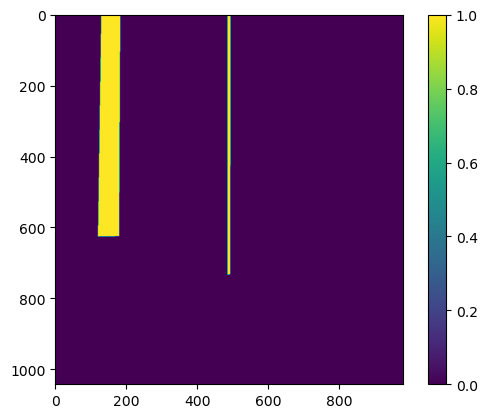

In [45]:
# Load a mask as np.array (can use any method)
draw = phs.IntegrationUtils.DrawMask(calib_DA)
draw.load(maskFile)

mask = draw.mask  # Loads mask as numpy array

# Show np.array mask:
plt.imshow(mask)
plt.colorbar()

# Initialize a transformer:
transformer = phs.GIWAXS.Transform(poniPath=poniFile, maskPath=maskFile, energy=12.7)
# transformer = phs.GIWAXS.Transform(poniPath=poniFile, maskPath=mask, energy=12.7)

In [46]:
CS_raw_DS, CS_recip_DS, CS_caked_DS = phs.GIWAXS.single_images_to_dataset(CS_set, CS_loader, transformer)  

Transforming Raw Data:   0%|          | 0/71 [00:00<?, ?it/s]

No save path or no filename specified, not saving zarrs... 


In [47]:
display(CS_recip_DS)

<xarray.Dataset>
Dimensions:  (q_z: 1073, q_xy: 981)
Coordinates:
  * q_z      (q_z) float64 -1.648 -1.644 -1.64 -1.636 ... 2.613 2.617 2.621
  * q_xy     (q_xy) float64 -1.913 -1.909 -1.905 -1.901 ... 2.104 2.108 2.112
Data variables: (12/72)
    1306998  (q_z, q_xy) float32 0.0 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0
    1306999  (q_z, q_xy) float64 nan nan nan nan nan nan ... 0.0 0.0 0.0 0.0 0.0
    1307000  (q_z, q_xy) float64 nan nan nan nan nan nan ... 0.0 0.0 0.0 0.0 0.0
    1307001  (q_z, q_xy) float64 nan nan nan nan nan nan ... 0.0 0.0 0.0 0.0 0.0
    1306990  (q_z, q_xy) float64 0.0 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0
    1306991  (q_z, q_xy) float64 nan nan nan nan nan nan ... 0.0 0.0 0.0 0.0 0.0
    ...       ...
    1307201  (q_z, q_xy) float64 nan nan nan nan nan nan ... 0.0 0.0 0.0 0.0 0.0
    1307202  (q_z, q_xy) float64 nan nan nan nan nan nan ... 0.0 0.0 0.0 0.0 0.0
    1307191  (q_z, q_xy) float64 0.0 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0
    1307192  (q_z, q_xy) float64 nan nan nan nan nan nan ... 0.0 0.0 0.0 0.0 0.0
    1307193  (q_z, q_xy) float64 nan nan nan nan nan nan ... 0.0 0.0 0.0 0.0 0.0
    1307194  (q_z, q_xy) float64 nan nan nan nan nan nan ... 0.0 0.0 0.0 0.0 0.0

In [48]:
display(CS_caked_DS)

<xarray.Dataset>
Dimensions:  (chi: 180, qr: 1000)
Coordinates:
  * chi      (chi) float64 -89.5 -88.5 -87.5 -86.5 -85.5 ... 86.5 87.5 88.5 89.5
  * qr       (qr) float64 0.0009976 0.00426 0.007523 ... 3.254 3.257 3.26
Data variables: (12/72)
    1306998  (chi, qr) float32 0.0 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0
    1306999  (chi, qr) float64 0.0 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 nan
    1307000  (chi, qr) float64 0.0 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0
    1307001  (chi, qr) float64 0.0 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0
    1306990  (chi, qr) float64 0.0 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0
    1306991  (chi, qr) float64 0.0 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 nan
    ...       ...
    1307201  (chi, qr) float64 0.0 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0
    1307202  (chi, qr) float64 0.0 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0
    1307191  (chi, qr) float64 0.0 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0
    1307192  (chi, qr) float64 0.0 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 nan
    1307193  (chi, qr) float64 0.0 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0
    1307194  (chi, qr) float64 0.0 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0

In [49]:
def select_attrs(data_arrays_iterable, selected_attrs_dict):
    """
    Selects data arrays whose attributes match the specified values.

    Parameters:
    data_arrays_iterable: Iterable of xarray.DataArray objects.
    selected_attrs_dict: Dictionary where keys are attribute names and 
                         values are the attributes' desired values.

    Returns:
    List of xarray.DataArray objects that match the specified attributes.
    """    
    sublist = list(data_arrays_iterable)
    
    for attr_name, attr_values in selected_attrs_dict.items():
        sublist = [da for da in sublist if da.attrs[attr_name] in attr_values]
                
    return sublist

  0%|          | 0/72 [00:00<?, ?it/s]

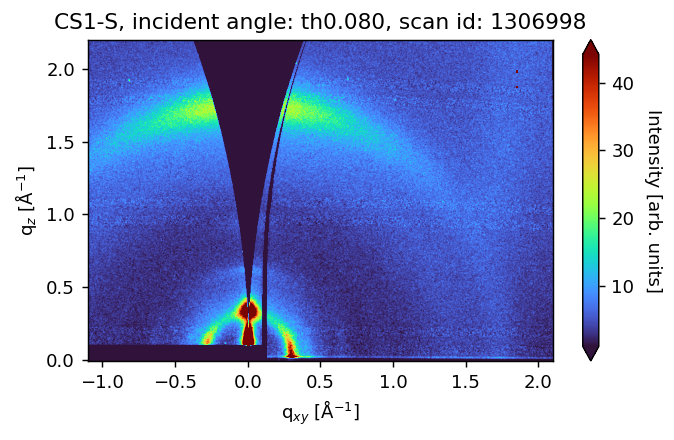

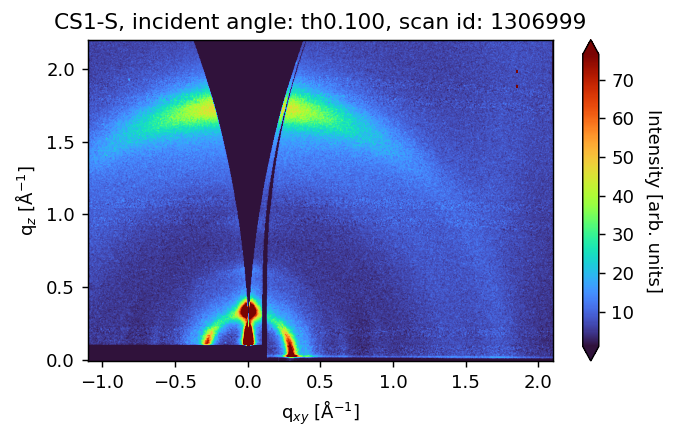

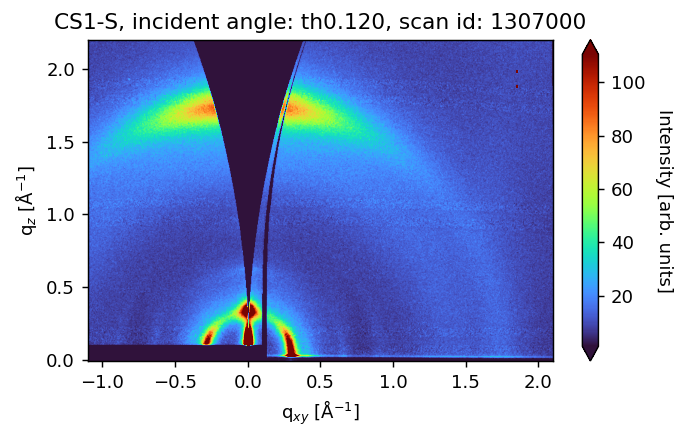

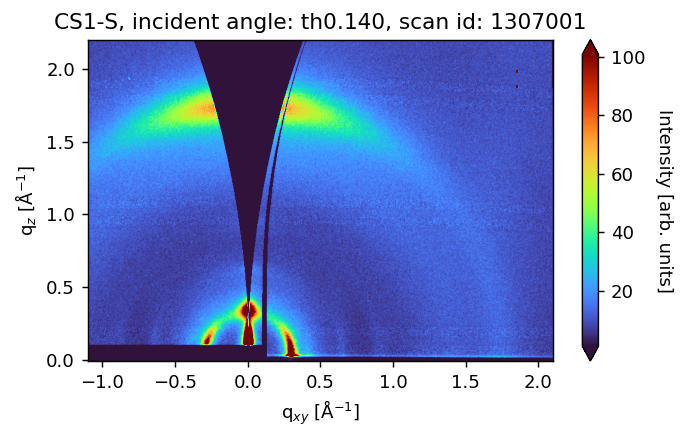

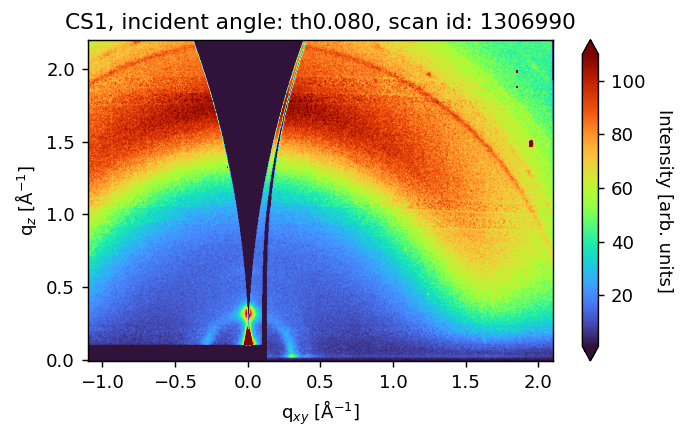

...

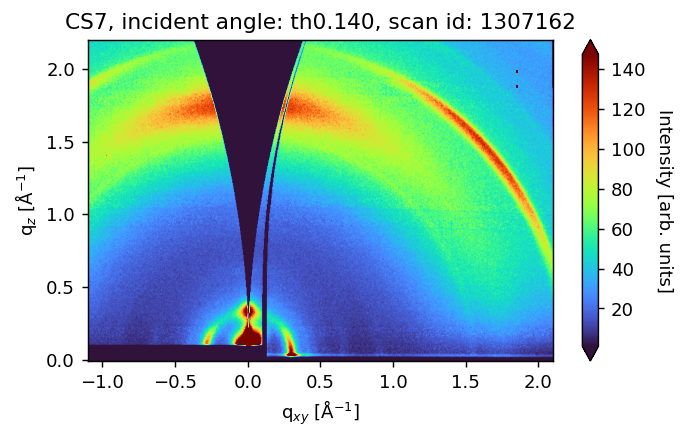

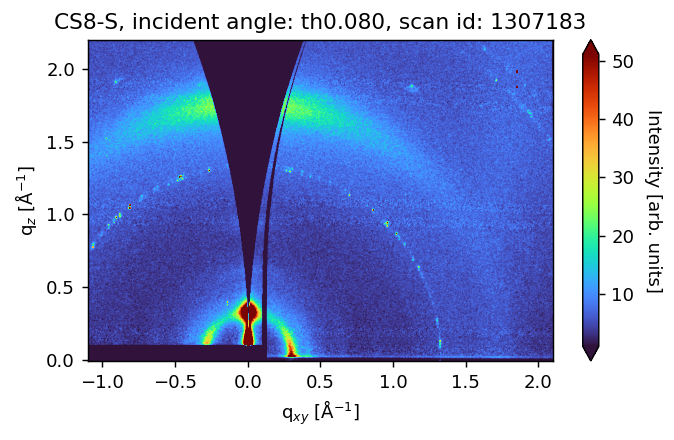

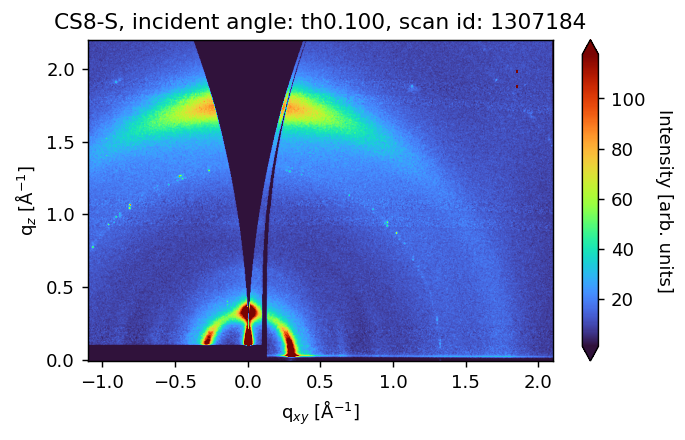

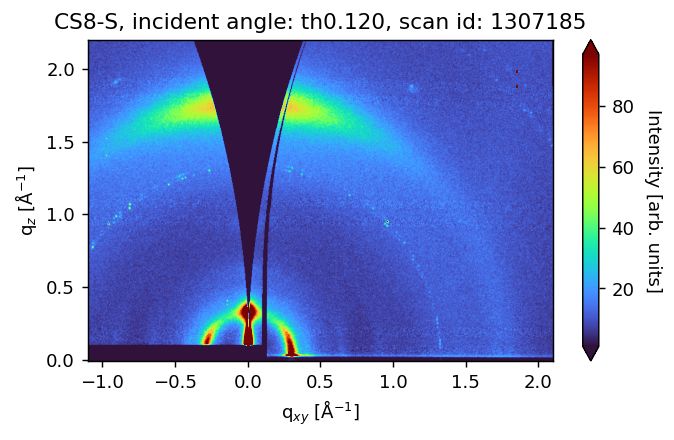

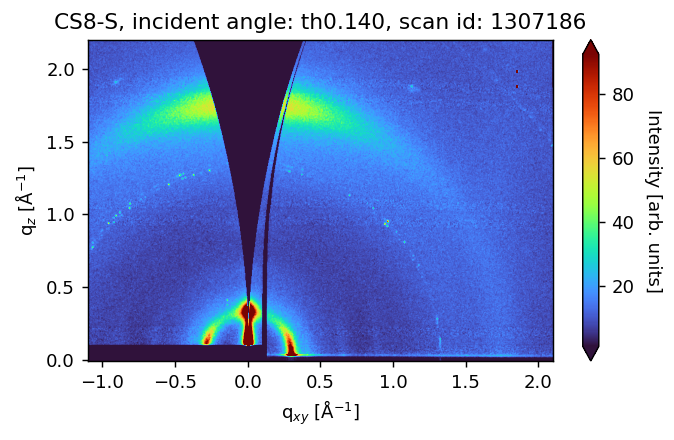

KeyboardInterrupt: 

In [50]:
# Example of a quick plot check if desired here:
# for DA in tqdm(fixed_recip_DS.data_vars.values()):   

selected_attrs_dict = {}
selected_DAs = select_attrs(CS_recip_DS.data_vars.values(), selected_attrs_dict)

for DA in tqdm(selected_DAs):   
    # Slice data for selected q ranges (will need to rename q_xy if dimensions are differently named)
    sliced_DA = DA.sel(q_xy=slice(-1.1, 2.1), q_z=slice(-0.01, 2.2))
    # sliced_DA = DA.sel(q_xy=slice(-0.5, -0.25), q_z=slice(1.5, 1.75))

    # real_min = float(DA.sel(q_xy=slice(-0.5, -0.1), q_z=slice(0.1, 0.4)).compute().quantile(1e-3))
    real_min = float(DA.compute().quantile(0.05))
    cmin = 1 if real_min < 1 else real_min
    
    # cmax = float(DA.sel(q_xy=slice(-0.5, -0.1), q_z=slice(0.1, 2)).compute().quantile(1))   
    cmax = float(DA.compute().quantile(0.999))   
    
    # Same plotting procedure as above
    # ax = sliced_DA.plot.imshow(cmap=cmap, norm=LogNorm(cmin, cmax), interpolation='antialiased', figsize=(5.5,3.3))
    ax = sliced_DA.plot.imshow(cmap=cmap, norm=plt.Normalize(cmin, cmax), interpolation='antialiased', figsize=(5.5,3.3))

    ax.colorbar.set_label('Intensity [arb. units]', rotation=270, labelpad=15)
    ax.axes.set(title=f'{DA.sampleid}, incident angle: {DA.incident_angle}, scan id: {DA.scan_id}',
                aspect='equal', xlabel='q$_{xy}$ [Å$^{-1}$]', ylabel='q$_z$ [Å$^{-1}$]')
    ax.figure.set(tight_layout=True, dpi=130)
    
    # ax.figure.savefig(outPath.joinpath('recip_plots/stitched_v2', f'{DA.material}_{DA.solvent}_{DA.incident_angle}.png'), dpi=120)
    plt.show()
    plt.close('all')

  0%|          | 0/72 [00:00<?, ?it/s]

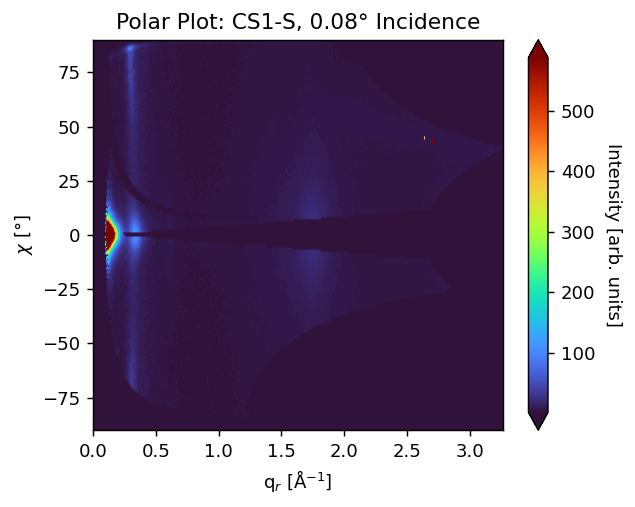

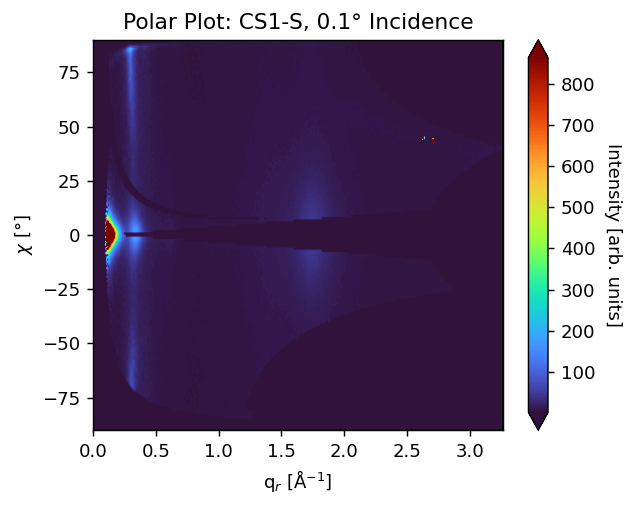

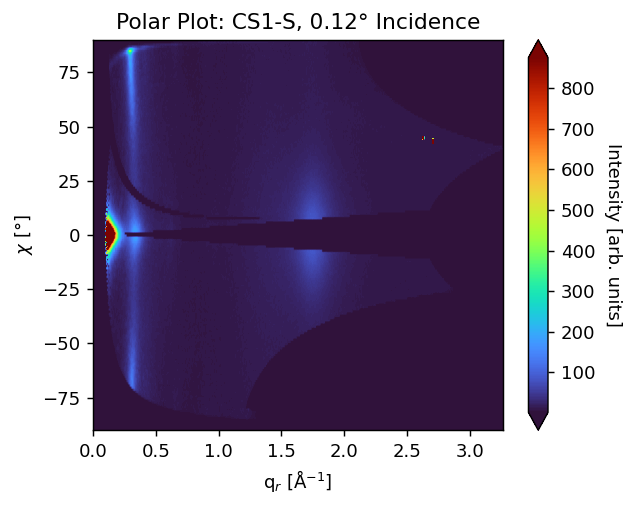

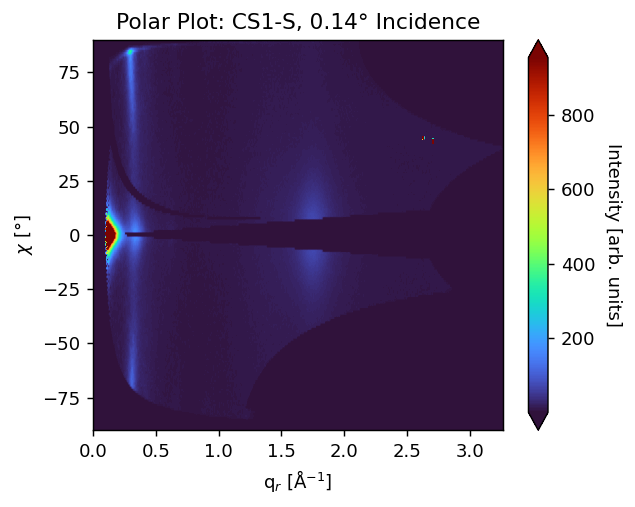

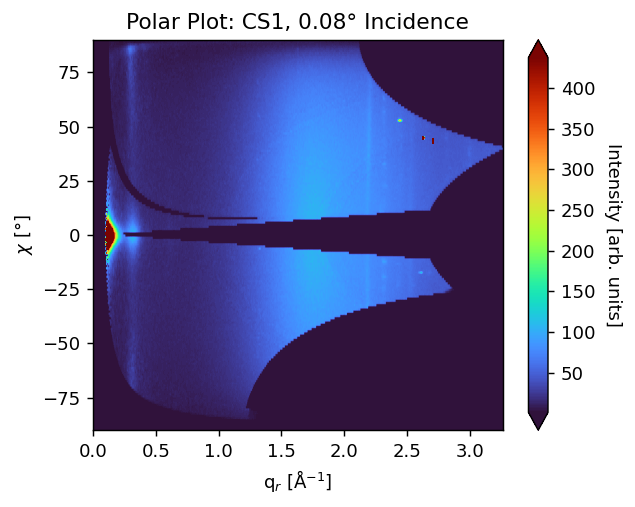

...

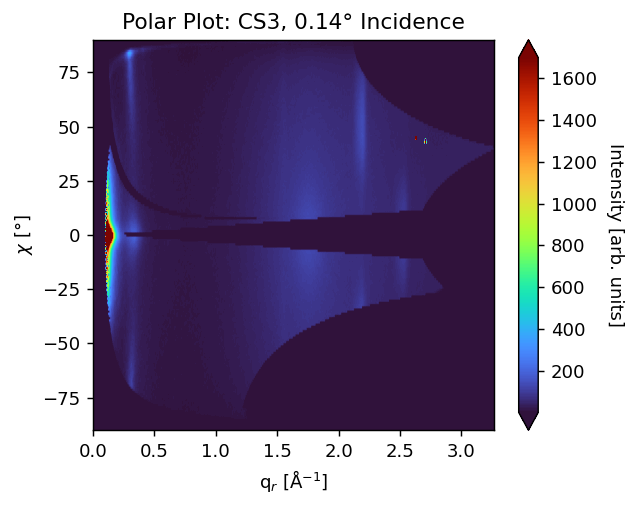

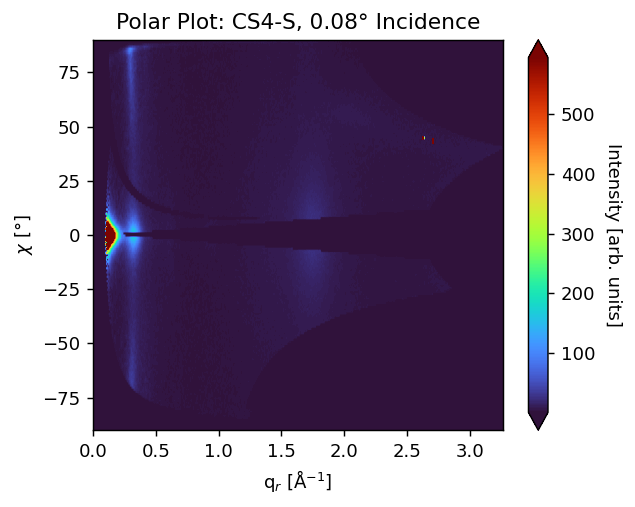

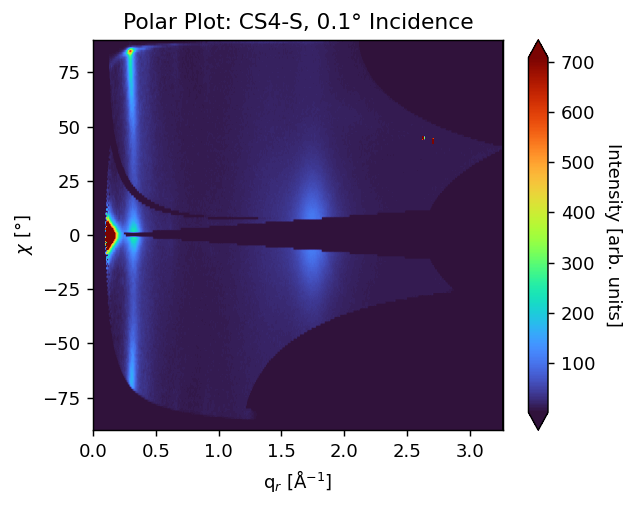

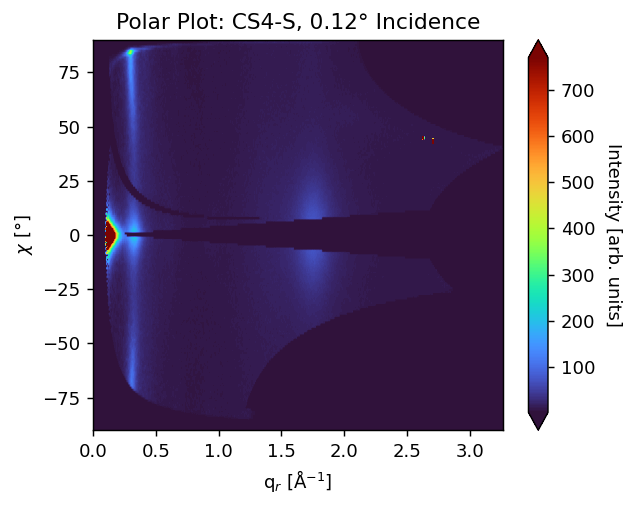

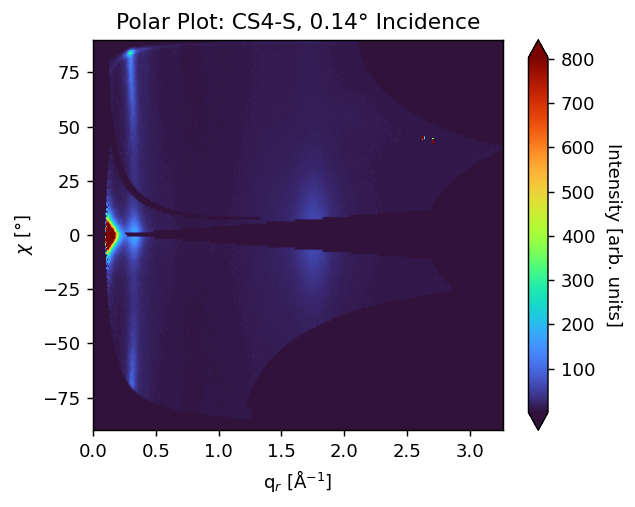


KeyboardInterrupt



In [51]:
chi_min = -90
chi_max = 90

selected_attrs_dict = {}
selected_DAs = select_attrs(CS_caked_DS.data_vars.values(), selected_attrs_dict)

for DA in tqdm(selected_DAs):
    # Slice dataarray to select plotting region 
    sliced_DA = DA.sel(chi=slice(chi_min,chi_max))
    
    # real_min = float(DA.sel(q_xy=slice(-0.5, -0.1), q_z=slice(0.1, 0.4)).compute().quantile(1e-3))
    real_min = float(DA.compute().quantile(0.05))
    cmin = 1 if real_min < 1 else real_min
    
    # cmax = float(DA.sel(q_xy=slice(-0.5, -0.1), q_z=slice(0.1, 2)).compute().quantile(1))   
    cmax = float(DA.compute().quantile(0.999))  
    
    # Plot sliced dataarray
    ax = sliced_DA.plot.imshow(cmap=cmap, norm=plt.Normalize(cmin, cmax), figsize=(5,4), interpolation='antialiased')  # plot, optional parameter interpolation='antialiased' for image smoothing
    ax.colorbar.set_label('Intensity [arb. units]', rotation=270, labelpad=15)  # set colorbar label & parameters 
    ax.axes.set(title=f'Polar Plot: {DA.sampleid}, {float(DA.incident_angle[2:])}° Incidence',
                xlabel='q$_r$ [Å$^{-1}$]', ylabel='$\chi$ [°]')  # set title, axis labels, misc
    ax.figure.set(tight_layout=True, dpi=130)  # Adjust figure dpi & plotting style
    
    plt.show()  # Comment to mute plotting output
    
    # Uncomment below line and set savepath/savename for saving plots, I usually like to check 
    # ax.figure.savefig(outPath.joinpath('PM6-Y6set_waxs', f'polar-2D_{DA.sample_id}_{chi_min}to{chi_max}chi_{DA.incident_angle}.png'), dpi=150)
    plt.close('all')

In [52]:
savePath

PosixPath('/nsls2/data/cms/proposals/2023-3/pass-311415/AL_processed_data/zarrs/bcy673')

In [53]:
CS_recip_DS.to_zarr(savePath.joinpath('CS_recip_stitched.zarr'), mode='w')

In [54]:
CS_raw_DS.to_zarr(savePath.joinpath('CS_raw_stitched.zarr'), mode='w')

In [55]:
CS_caked_DS.to_zarr(savePath.joinpath('CS_caked_stitched.zarr'), mode='w')